# __Identify Scaffolds from a set of molecules__

## Pat Walters introduction to the notebook

**In Cheminformatics, we frequently run into cases where we want to understand structure-activity relationships in a set of molecules. In order to do this, we typically separate the molecules based on common scaffolds, then create an R-group table to explore the substituents that have been attached to the scaffold. In addition, identifying scaffolds allows us to perform tasks like aligning molecules that will enable us to more easily compare the molecules. In this notebook we'll use a method inspired by a 2019 paper by Naveja, Vogt, Stumpfe, Medina-Franco, and Bajorath. The method operates by carrying out three steps.**

1. Decompose each molecule into a set of fragments. In this case we'll use the FragmentMol function from the Matched Molecular Pair Analysis (MMPA) functions in the RDKit decompose a molecule into a set of fragments. The RDKit MMPA methods use the Hussain and Rea methodology, which fragments a molecule by successively disconnecting acyclic single bonds.

2. Remove any fragments where the number of atoms is less than 2/3 the number of atoms in the original molecule.

3. Collect fragments and records their frequency. We can do this easily using the Pandas groupby method.

**All of these functions have been encapsulated in a small python library called scaffold_finder. In this notebook, we'll use four functions from this library.**

- generate_fragments - performs steps 1 and 2 above.

- find scaffolds - performs step 3 above

- cleanup_fragments - takes a set of fragments generated by steps 1 and 2 above, and coverts them to scaffolds

- get_molecules_with_scaffold - select molecules containing a specified fragment from a Pandas dataframe.

## Requirements for notebook
!pip install pandas requests mols2grid useful-rdkit-utils

In [1]:
# Obtaining the scaffold_finder script
#import requests
#lib_file = requests.get("https://raw.githubusercontent.com/PatWalters/practical_cheminformatics_tutorials/main/sar_analysis/scaffold_finder.py")
#ofs = open("scaffold_finder.py","w")
#print(lib_file.text,file=ofs)
#ofs.close()

#Import libraries
import pandas as pd
from rdkit import Chem
from rdkit.Chem import AllChem
from rdkit.Chem.rdDepictor import Compute2DCoords
from io import StringIO
import mols2grid
from scaffold_finder import generate_fragments, find_scaffolds, get_molecules_with_scaffold, cleanup_fragment

# The funtions for the scaffold_finder

import sys
from rdkit import Chem
from rdkit.Chem.rdMMPA import FragmentMol
from rdkit.Chem.rdRGroupDecomposition import RGroupDecompose
import itertools
import useful_rdkit_utils as uru
import pandas as pd
from tqdm.auto import tqdm
from glob import glob
import numpy as np


def cleanup_fragment(mol):
    """
    Replace atom map numbers with Hydrogens
    :param mol: input molecule
    :return: modified molecule, number of R-groups
    """
    rgroup_count = 0
    for atm in mol.GetAtoms():
        atm.SetAtomMapNum(0)
        if atm.GetAtomicNum() == 0:
            rgroup_count += 1
            atm.SetAtomicNum(1)
    mol = Chem.RemoveAllHs(mol)
    return mol, rgroup_count


def generate_fragments(mol):
    """
    Generate fragments using the RDKit
    :param mol: RDKit molecule
    :return: a Pandas dataframe with Scaffold SMILES, Number of Atoms, Number of R-Groups
    """
    # Generate molecule fragments
    frag_list = FragmentMol(mol)
    # Flatten the output into a single list
    flat_frag_list = [x for x in itertools.chain(*frag_list) if x]
    # The output of Fragment mol is contained in single molecules.  Extract the largest fragment from each molecule
    flat_frag_list = [uru.get_largest_fragment(x) for x in flat_frag_list]
    # Keep fragments where the number of atoms in the fragment is at least 2/3 of the number fragments in
    # input molecule
    num_mol_atoms = mol.GetNumAtoms()
    flat_frag_list = [x for x in flat_frag_list if x.GetNumAtoms() / num_mol_atoms > 0.67]
    # remove atom map numbers from the fragments
    flat_frag_list = [cleanup_fragment(x) for x in flat_frag_list]
    # Convert fragments to SMILES
    frag_smiles_list = [[Chem.MolToSmiles(x), x.GetNumAtoms(), y] for (x, y) in flat_frag_list]
    # Add the input molecule to the fragment list
    frag_smiles_list.append([Chem.MolToSmiles(mol), mol.GetNumAtoms(), 1])
    # Put the results into a Pandas dataframe
    frag_df = pd.DataFrame(frag_smiles_list, columns=["Scaffold", "NumAtoms", "NumRgroupgs"])
    # Remove duplicate fragments
    frag_df = frag_df.drop_duplicates("Scaffold")
    return frag_df


def find_scaffolds(df_in):
    """
    Generate scaffolds for a set of molecules
    :param df_in: Pandas dataframe with [SMILES, Name, RDKit molecule] columns
    :return: dataframe with molecules and scaffolds, dataframe with unique scaffolds
    """
    # Loop over molecules and generate fragments, fragments for each molecule are returned as a Pandas dataframe
    df_list = []
    for smiles, name, mol in tqdm(df_in[["SMILES", "Name", "mol"]].values):
        tmp_df = generate_fragments(mol).copy()
        tmp_df['Name'] = name
        tmp_df['SMILES'] = smiles
        df_list.append(tmp_df)
    # Combine the list of dataframes into a single dataframe
    mol_df = pd.concat(df_list)
    # Collect scaffolds
    scaffold_list = []
    for k, v in mol_df.groupby("Scaffold"):
        scaffold_list.append([k, len(v.Name.unique()), v.NumAtoms.values[0]])
    scaffold_df = pd.DataFrame(scaffold_list, columns=["Scaffold", "Count", "NumAtoms"])
    # Any fragment that occurs more times than the number of fragments can't be a scaffold
    num_df_rows = len(df_in)
    scaffold_df = scaffold_df.query("Count <= @num_df_rows")
    # Sort scaffolds by frequency
    scaffold_df = scaffold_df.sort_values(["Count", "NumAtoms"], ascending=[False, False])
    return mol_df, scaffold_df


def get_molecules_with_scaffold(scaffold, mol_df, activity_df):
    """
    Associate molecules with scaffolds
    :param scaffold: scaffold SMILES
    :param mol_df: dataframe with molecules and scaffolds, returned by find_scaffolds()
    :param activity_df: dataframe with [SMILES, Name, pIC50] columns
    :return: list of core(s) with R-groups labeled, dataframe with [SMILES, Name, pIC50]
    """
    match_df = mol_df.query("Scaffold == @scaffold")
    merge_df = match_df.merge(activity_df, on=["SMILES", "Name"])
    scaffold_mol = Chem.MolFromSmiles(scaffold)
    rgroup_match, rgroup_miss = RGroupDecompose(scaffold_mol, merge_df.mol, asSmiles=True)
    if len(rgroup_match):
        rgroup_df = pd.DataFrame(rgroup_match)
        return rgroup_df.Core.unique(), merge_df[["SMILES", "Name", "pIC50"]]
    else:
        return [], merge_df[["SMILES", "Name", "pIC50"]]


def main():
    """
    Read all SMILES files in the current directory, generate scaffolds, report stats for each scaffold
    :return: None
    """
    filename_list = glob("CHEMBL237.smi")
    out_list = []
    for filename in filename_list:
        print(filename)
        input_df = pd.read_csv(filename, names=["SMILES", "Name", "pIC50"])
        input_df['mol'] = input_df.SMILES.apply(Chem.MolFromSmiles)
        input_df['SMILES'] = input_df.mol.apply(Chem.MolToSmiles)
        mol_df, scaffold_df = find_scaffolds(input_df)
        scaffold_1 = scaffold_df.Scaffold.values[0]
        scaffold_list, scaffold_mol_df = get_molecules_with_scaffold(scaffold_1, mol_df, input_df)
        ic50_list = scaffold_mol_df.pIC50
        if len(scaffold_list):
            print(scaffold_list[0], len(scaffold_mol_df), max(ic50_list) - min(ic50_list), np.std(ic50_list))
            out_list.append([filename, scaffold_list[0], len(scaffold_mol_df), max(ic50_list) - min(ic50_list),
                             np.std(ic50_list)])
        else:
            print(f"Could not find a scaffold for {filename}", file=sys.stderr)
    out_df = pd.DataFrame(out_list, columns=["Filename", "Scaffold", "Count", "Range", "Std"])
    out_df.to_csv("scaffold_stats.csv", index=False)


if __name__ == "__main__":
    main()




In [2]:
#Example using a small number of molecules in a buff string
hypertension_drugs = """CCCCC(=O)N(CC1=CC=C(C=C1)C2=CC=CC=C2C3=NNN=N3)[C@@H](C(C)C)C(=O)O,Valsartan
CC(C)NCC(COC1=CC=C(C=C1)CC(=O)N)O,Atenolol
CCOC(=O)[C@H](CCC1=CC=CC=C1)N[C@@H](C)C(=O)N2CCC[C@H]2C(=O)O,Enalapril
COC1=CC=CC=C1OCCNCC(COC2=CC=CC3=C2C4=CC=CC=C4N3)O,Carvedilol
CCOC(=O)C(CCC1=CC=CC=C1)NC(C)C(=O)N2C3CCCC3CC2C(=O)O,Ramipril
"""
#Convert the string to a file-like object
hypertension_drugs_file = StringIO(hypertension_drugs)

#Read the file as a dataframe
df = pd.read_csv(hypertension_drugs_file, names=["SMILES", "Name"])

# Add RDkit molecules using the SMILES to the dataframe
df["rdkit_mol"] = df.SMILES.apply(Chem.MolFromSmiles)

# Visualize the molecules
mols2grid.display(df,
                  mol_col="rdkit_mol",
                  size=(200,200))

MolGridWidget()

In [3]:
# Fragmenting the first molecule
# Save first molecule
mol_0 = df.rdkit_mol.values[0]
# Fragmenting the first molecule
mol_0_frag_df = generate_fragments(mol_0)
mol_0_frag_df # Many fragments are made. It does not just fragment left to right 

# Visulaize the fragments
mols2grid.display(mol_0_frag_df,smiles_col="Scaffold")

MolGridWidget()

In [4]:
# Fragment the second molecule 
# Save it as a variable
mol_1 = df.rdkit_mol.values[1]

#Fragment the second molecule
mol_1_frag_df = generate_fragments(mol_1)

# Visualize the fragments
mols2grid.display(mol_1_frag_df, 
                  smiles_col="Scaffold")


MolGridWidget()

In [5]:
# Combing the mol_0_frag_df and mol_1_frag_df to count the number of matching fragments
combined_frag_df = pd.concat([mol_0_frag_df, mol_1_frag_df])

# Count the number of matching fragments
scaffold_list = []

# Loop over the fragments
for k,v in combined_frag_df.groupby("Scaffold"):
    scaffold_list.append([k, len(v), v.NumAtoms.values[0]])
    
# Convert the list to a dataframe
scaffold_df = pd.DataFrame(scaffold_list, columns=["Scaffold", "Count", "NumAtoms"])

# Sort the values by Count and NumaAtoms
scaffold_df.sort_values(["Count", "NumAtoms"], ascending=[False,False], inplace=True)

In [6]:
# Visualize the merged scaffold dataframe
mols2grid.display(scaffold_df,
                  smiles_col="Scaffold",
                  subset=["img","Count","NumAtoms"]
                  )

MolGridWidget()

In [7]:
# Using find_scaffold function to find scaffolds i all the molecules
find_scaffolds

mol_df, scaf_df = find_scaffolds(df,Name="Name",mol="rdkit_mol",SMILES="SMILES")
mols2grid.display(scaf_df,
                  smiles_col="Scaffold",
                  subset=["img","Count","NumAtoms"]
                  )

  0%|          | 0/5 [00:00<?, ?it/s]

MolGridWidget()

In [8]:
# Conducting the same on a large dataset
# Load HDAC1 data
df = pd.read_csv("HDAC1_ChEMBL_prepared_data/HDAC1_ChEMBL_IC50.csv")

# Add rdkit molecules using smiles
df["rdkit_mol"] = df.SMILES.apply(Chem.MolFromSmiles)

df.head()

,Unnamed: 0,molecule_chembl_id,IC50,units,SMILES,pIC50,activity_label,ML_activity_label,rdkit_mol
0,0,CHEMBL3621294,0.00687,nM,O=C(CCCCCCC(=O)Nc1ccc2c(c1)/C(=C/c1ccc[nH]1)C(...,11.163043,active,1,<rdkit.Chem.rdchem.Mol object at 0x1243c2340>
1,1,CHEMBL3689858,0.01000,nM,CCC(CC)CN(CC)Cc1c(C)nc2cc(/C=C/C(=O)NO)ccn12,11.000000,active,1,<rdkit.Chem.rdchem.Mol object at 0x1245b4120>
2,2,CHEMBL3689829,0.02000,nM,CCCCNCc1c(CCCC)nc2cc(/C=C/C(=O)NO)ccn12,10.698970,active,1,<rdkit.Chem.rdchem.Mol object at 0x1245b4190>
3,3,CHEMBL4861467,0.05000,nM,CCC(=O)CCCCC[C@H](NC(=O)[C@H]1CC12CCN(CC1CC1)C...,10.301030,active,1,<rdkit.Chem.rdchem.Mol object at 0x1245b4200>
4,4,CHEMBL3689834,0.06000,nM,CCCCc1nc2cc(/C=C/C(=O)NO)ccn2c1CN(CC)CCCC,10.221849,active,1,<rdkit.Chem.rdchem.Mol object at 0x1245b4270>


In [9]:
# Identify the scaffolds
mol_df,scaffold_df = find_scaffolds(df,
                                Name="molecule_chembl_id",
                                mol="rdkit_mol",
                                SMILES="SMILES"
                                )

# look at scaffolds_df
scaffold_df

  0%|          | 0/5752 [00:00<?, ?it/s]

,Scaffold,Count,NumAtoms
105286,Nc1ccccc1NC(=O)CCCCCNC=O,108,18
119138,O=CNCCCCCC(=O)Nc1ccccc1,108,17
116003,O=C(Nc1cccc(-c2ccccc2)c1)c1ccccc1,106,21
94866,Cc1ccc(C(=O)Nc2cccc(-c3ccccc3)c2)cc1,94,22
57783,CCNCc1cnc2cc(C=CC(=O)NO)ccn12,86,19
...,...,...,...
121642,c1cncnc1,1,6
23324,CCC(=O)[O-],1,5
11693,CC(=O)O,1,4
12100,CC(=O)[O-],1,4


In [10]:
#Sort scaffold by Count
#scaffold_df.sort_values(["Count"], ascending=[False], inplace=True)

# Viusalize the results
mols2grid.display(scaffold_df,
                  smiles_col="Scaffold",
                  subset=["img","Count"],
                  size=(200,200))

MolGridWidget()

## Using the function get_molecules_with_scaffold we are able to get compounds containing a specific scaffold

**Two values are returned:**

1. A list of scaffolds with R-group substitution points labeled

2. A dataframe with molecules containing that scaffold

In [11]:
mol_df.head()

,Scaffold,NumAtoms,NumRgroupgs,molecule_chembl_id,SMILES
0,CCCCCCC(=O)Nc1ccc2c(c1)/C(=C/c1ccc[nH]1)C(=O)N2,25,1,CHEMBL3621294,O=C(CCCCCCC(=O)Nc1ccc2c(c1)/C(=C/c1ccc[nH]1)C(...
1,CCCCCC(=O)Nc1ccc2c(c1)C(=Cc1ccc[nH]1)C(=O)N2,24,1,CHEMBL3621294,O=C(CCCCCCC(=O)Nc1ccc2c(c1)/C(=C/c1ccc[nH]1)C(...
2,CCCCC(=O)Nc1ccc2c(c1)C(=Cc1ccc[nH]1)C(=O)N2,23,1,CHEMBL3621294,O=C(CCCCCCC(=O)Nc1ccc2c(c1)/C(=C/c1ccc[nH]1)C(...
3,CCCC(=O)Nc1ccc2c(c1)C(=Cc1ccc[nH]1)C(=O)N2,22,1,CHEMBL3621294,O=C(CCCCCCC(=O)Nc1ccc2c(c1)/C(=C/c1ccc[nH]1)C(...
4,CCC(=O)Nc1ccc2c(c1)C(=Cc1ccc[nH]1)C(=O)N2,21,1,CHEMBL3621294,O=C(CCCCCCC(=O)Nc1ccc2c(c1)/C(=C/c1ccc[nH]1)C(...


In [20]:
scaffold_0 = scaffold_df.Scaffold.values[3]
scaffold_0

'Cc1ccc(C(=O)Nc2cccc(-c3ccccc3)c2)cc1'

In [21]:
# Select most common scaffold
scaffold_0 = scaffold_df.Scaffold.values[0]

# Finding molecules with the scaffold
scaffold_smiles_list, HDAC1_mol_df = get_molecules_with_scaffold(scaffold_0, 
                                                                 mol_df, 
                                                                 df, 
                                                                 Name="molecule_chembl_id",
                                                                 mol="rdkit_mol",)

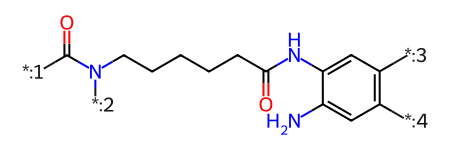

In [22]:
# Visualize the scaffold with R-groups
scaffold_mol = Chem.MolFromSmiles(scaffold_smiles_list[0])
scaffold_mol

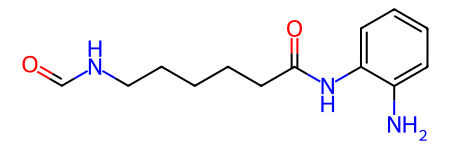

In [23]:
# Remove R-groups and visualize the cleaned molecule
clean_scaffold_mol, _ = cleanup_fragment(scaffold_mol)
Compute2DCoords(clean_scaffold_mol)
clean_scaffold_mol

In [24]:
# Generate Rdkit molecules from the scaffold Smiles
HDAC1_mol_df['rdkit_mol'] = HDAC1_mol_df.SMILES.apply(Chem.MolFromSmiles)

# Aligning the molecules that have the scaffold within the chemical strcuture
for mol in HDAC1_mol_df.rdkit_mol:
    AllChem.GenerateDepictionMatching2DStructure(mol, clean_scaffold_mol)

#Visulaize the molecules with the scaffold within the chemical structure
mols2grid.display(HDAC1_mol_df.sort_values("pIC50",ascending=False),
                  mol_col='rdkit_mol',use_coords=True, prerender=True, substruct_highlight=False,
                  transform={"pIC50" : lambda x: f"{x:.1f}"},
                  subset=["molecule_chembl_id","img","pIC50"])

MolGridWidget()